In [1]:
%matplotlib inline

import numpy as np
import supervisely_lib as sly
from supervisely_lib.geometry.bitmap import Bitmap

import matplotlib.pyplot as plt

import pandas as pd

import os

from skimage import io
from skimage import exposure
from skimage import transform
from skimage import color
from skimage import measure

import mpld3
mpld3.enable_notebook()

In [2]:
# Change this field to the name of your team, where target workspace exists.
team_name = "marcwang17" # Automatically inserted

# Change this field to the of your workspace, where target project exists.
workspace_name = "First Workspace" # Automatically inserted

# If you are running this notebook on a Supervisely web instance, the connection
# Edit those values if you run this notebook on your own PC
# details below will be filled in from environment variables automatically.
#
# If you are running this notebook locally on your own machine, edit to fill in the
# connection details manually. You can find your access token at
# "Your name on the top right" -> "Account settings" -> "API token".
address = os.environ['SERVER_ADDRESS']
token = os.environ['API_TOKEN']

In [3]:
# Initialize API object
api = sly.Api(address, token)

In [4]:
team = api.team.get_info_by_name(team_name)
if team is None:
    raise RuntimeError("Team {!r} not found".format(team_name))

workspace = api.workspace.get_info_by_name(team.id, workspace_name)
if workspace is None:
    raise RuntimeError("Workspace {!r} not found".format(workspace_name))
    
print("Team: id={}, name={}".format(team.id, team.name))
print("Workspace: id={}, name={}".format(workspace.id, workspace.name))

Team: id=25454, name=marcwang17
Workspace: id=28720, name=First Workspace


In [5]:
# Set the destination model name within our workspace
model_name = "real_trained"

model = api.model.get_info_by_name(workspace.id, model_name)
print("Model: id = {}, name = {!r}".format(model.id, model.name))

Model: id = 16968, name = 'real_trained'


In [6]:
# Replace this with your agent name. You can find the list of
# all your agents in the "Cluster" menu in the Supervisely instance.
agent_name = "Dazzling Duck"

agent = api.agent.get_info_by_name(team.id, agent_name)
if agent is None:
    raise RuntimeError("Agent {!r} not found".format(agent_name))
if agent.status is api.agent.Status.WAITING:
    raise RuntimeError("Agent {!r} is not running".format(agent_name))

In [8]:
# Just in case that the model has been already deployed
# (maybe you are re-running some of this tutorial several times)
# we want to reuse the already deployed version.
#
# Query the web instance for already deployed instances of our model.
task_ids = api.model.get_deploy_tasks(model.id)

# Deploy if necessary.
if len(task_ids) == 0:
    print('Model {!r} is not deployed. Deploying...'.format(model.name))
    task_id = api.task.deploy_model(agent.id, model.id)
    # deploy_model() kicks off an asynchronous task that may take
    # quite a long time - after all, the agent on the worker needs to
    # * Download the model weights from web instance.
    # * Pull the docker image with the model code.
    # * Launch a docker image and wait for it to load the weights onto the GPU.
    #
    # Since we don't have other tasks to process, simply wait
    # for deployment to finish.
    api.task.wait(task_id, api.task.Status.DEPLOYED)
else:
    print('Model {!r} has been already deployed'.format(model.name))
    task_id = task_ids[0]

print('Deploy task_id = {}'.format(task_id))

Model 'real_trained' is not deployed. Deploying...
Deploy task_id = 169320


In [9]:
meta_json = api.model.get_output_meta(model.id)
model_meta = sly.ProjectMeta.from_json(meta_json)
print(model_meta)

ProjectMeta:
Object Classes
+-------------------+--------+----------------+
|        Name       | Shape  |     Color      |
+-------------------+--------+----------------+
|   particle_model  | Bitmap | [177, 36, 25]  |
| particle_wh_model | Bitmap | [74, 144, 226] |
|      bg_model     | Bitmap | [35, 138, 15]  |
+-------------------+--------+----------------+
Tags
+------------------+------------+-----------------+
|       Name       | Value type | Possible values |
+------------------+------------+-----------------+
| confidence_model | any_number |       None      |
+------------------+------------+-----------------+



In [7]:
path_im = "./data/process_map/2020-03-04 Marc PM2 C4_5um scan_recon.tiff"

In [8]:
im = io.imread(path_im)

In [9]:
im.shape

(1012, 1024, 1004)

In [10]:
sub_im = im[50,250:500,250:500]

upsampled = transform.rescale(sub_im, scale = 4, preserve_range = True)

contrast_equiv = exposure.equalize_hist(upsampled, mask = upsampled != 0)
rgb_im = color.gray2rgb(contrast_equiv)

rescaled_im = exposure.rescale_intensity(rgb_im, out_range=np.uint8).astype(np.uint8)

In [11]:
rescaled_im.shape

(1000, 1000, 3)

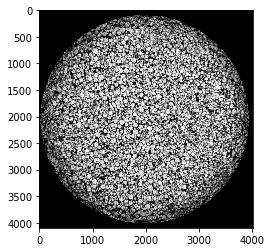

In [63]:
plt.imshow(rescaled_im, cmap = 'gray')
plt.show()

In [12]:
project_name = 'test_full'

project = api.project.get_info_by_name(workspace.id, project_name)
if project is None:
    project = api.project.create(workspace.id, project_name, change_name_if_conflict=True)


dataset = api.dataset.create(project.id, 'full_im', change_name_if_conflict=True)

api.image.upload_np(dataset.id, 'im_01.png', rescaled_im)

ImageInfo(id=152942756, name='im_01.png', link=None, hash='bBC9EitKs0qM4dPIzC7QGTfJlVYclIL29oES3ankPHg=', mime='image/png', ext='png', size=1626369, width=1000, height=1000, labels_count=0, dataset_id=318332, created_at='2020-04-30T18:11:22.470Z', updated_at='2020-04-30T18:11:22.470Z')

In [14]:
inf_config = {
    "name": "full_image",
    "model_classes": {
      "save_classes": "__all__",
      "add_suffix": "_maskrcnn"
    }
}


In [15]:
# Make an inference request, get a JSON serialized image annotation.
ann_json = api.model.inference(model.id, rgb_im, mode = inf_config)

# Deserialize the annotation using the model meta information that
# we received previously.
ann = sly.Annotation.from_json(ann_json, model_meta)

In [16]:
ann_json

{'description': '',
 'size': {'height': 256, 'width': 256},
 'tags': [],
 'objects': [],
 'success': True}

In [18]:
deploy_task_id = api.model.get_deploy_tasks(model.id)[0]
print(deploy_task_id)

api.task.stop(deploy_task_id)
api.task.wait(deploy_task_id, api.task.Status.STOPPED)
print('task {} has been successfully stopped'.format(deploy_task_id))
print(api.task.get_status(deploy_task_id))

169320
task 169320 has been successfully stopped
Status.STOPPED


In [ ]:
list_diameter = []

for particle_label in ann.labels:
    bitmap_obj = particle_label.geometry
    mask = bitmap_obj.data.astype(float)
    
    origin = bitmap_obj.origin
    
    
    M = measure.moments(mask)
    
    area = M[0,0]
    local_centroid = np.array([M[1, 0] / M[0, 0], M[0, 1] / M[0, 0]])
    
    global_centroid = local_centroid + np.array([origin.row, origin.col])
    
    equiv_diameter = np.sqrt(4*area/np.pi)
    
    list_diameter.append(equiv_diameter)
    

In [ ]:
fig, ax = plt.subplots()
ax.imshow(im[50,...], cmap = 'gray')
plt.show()

In [ ]:
img = sly.image.read('./image_01.jpeg')

# Make an inference request, get a JSON serialized image annotation.
ann_json = api.model.inference(model.id, img)

# Deserialize the annotation using the model meta information that
# we received previously.
ann = sly.Annotation.from_json(ann_json, model_meta)

# Render the inference results.
draw_labeled_image(img, ann)